<a href="https://colab.research.google.com/github/Raihan4520/YOLO11/blob/main/Pose_Detection_YOLO11.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Pose Detection** using YOLO11

In [ ]:
# Check GPU
!nvidia-smi


/bin/bash: line 1: nvidia-smi: command not found


In [ ]:
# Install the necessary libraries
!pip install ultralytics roboflow opencv-python pandas


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 881.7/881.7 kB 10.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.4/80.4 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 2.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 2.9 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


In [ ]:
# Download the dataset
# !pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="LEWZ7sEY1aJk3PwALClb")
project = rf.workspace("pose-detection-twxbg").project("human-activity-ce7zu")
version = project.version(1)
dataset = version.download("yolov8")

# Dataset link: https://universe.roboflow.com/pose-detection-twxbg/human-activity-ce7zu/dataset/1#

"""
Note: Unable to download dataset directly from roboflow.
So, downloaded dataset zip file to my computer and uploaded it to my google drive.
If you do the same then make sure to rename the dataset correctly and update the paths accordingly.
"""


loading Roboflow workspace...
loading Roboflow project...
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Dependency ultralytics==8.0.196 is required but found version=8.3.4, to fix: `pip install ultralytics==8.0.196`


RuntimeError: {'error': 'Unknown error'}

In [ ]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
# Import necessary libraries to unzip
import os
import zipfile

# Define path to the zip file in Google Drive
zip_file_path = '/content/drive/MyDrive/Colab Notebooks/YOLO11/Human-activity-1.zip'

# Define extraction folder
extract_folder = '/content/'

# Check if the zip file exists in the specified location
if os.path.exists(zip_file_path):
    print(f"Found {zip_file_path}")

    # Extract the dataset into the /content folder
    with zipfile.ZipFile(zip_file_path, 'r') as zip_ref:
        zip_ref.extractall(extract_folder)
    print(f"Dataset extracted to {extract_folder}")
else:
    print(f"File {zip_file_path} not found. Please check the path.")


Found /content/drive/MyDrive/Colab Notebooks/YOLO11/Human-activity-1.zip
Dataset extracted to /content/


In [ ]:
# *** Change path in data.yaml file for Google Colab ***
# path: /content/Human-activity-1
# test: test/images    # relative to 'path'
# train: train/images  # relative to 'path'
# val: valid/images    # relative to 'path'


In [ ]:
# Train the YOLO11 model
from ultralytics import YOLO
import os

# Path to the data.yaml file
# data_yaml_path = os.path.join(dataset.location, 'data.yaml')
data_yaml_path = "/content/Human-activity-1/data.yaml"

# Initialize the YOLO11 model - using the nano model for speed
model = YOLO('yolo11n-pose.pt')  # Load a pretrained YOLO11 model

# Train the model
model.train(task='pose', mode='train', data=data_yaml_path, epochs=10) # task and mode are optional parameters

# Train using CLI (In this project all python code is used instead of CLI)
# !yolo task=pose mode=train model=yolo11n-pose.pt data=data_yaml_path epochs=10


100%|██████████| 5.97M/5.97M [00:00<00:00, 79.9MB/s]


Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
engine/trainer: task=pose, mode=train, model=yolo11n-pose.pt, data=/content/Human-activity-1/data.yaml, epochs=10, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=True, sh

100%|██████████| 755k/755k [00:00<00:00, 19.9MB/s]


Overriding model.yaml nc=80 with nc=4

                   from  n    params  module                                       arguments                     
  0                  -1  1       464  ultralytics.nn.modules.conv.Conv             [3, 16, 3, 2]                 
  1                  -1  1      4672  ultralytics.nn.modules.conv.Conv             [16, 32, 3, 2]                
  2                  -1  1      6640  ultralytics.nn.modules.block.C3k2            [32, 64, 1, False, 0.25]      
  3                  -1  1     36992  ultralytics.nn.modules.conv.Conv             [64, 64, 3, 2]                
  4                  -1  1     26080  ultralytics.nn.modules.block.C3k2            [64, 128, 1, False, 0.25]     
  5                  -1  1    147712  ultralytics.nn.modules.conv.Conv             [128, 128, 3, 2]              
  6                  -1  1     87040  ultralytics.nn.modules.block.C3k2            [128, 128, 1, True]           
  7                  -1  1    295424  ultralytics

train: Scanning /content/Human-activity-1/train/labels... 1382 images, 6 backgrounds, 4 corrupt: 100%|██████████| 1382/1382 [00:01<00:00, 1001.67it/s]

train: WARNING ⚠️ /content/Human-activity-1/train/images/clideo_editor_3b33d792dfde4f1b8b2dd2fdf082e347_mp4-0048_jpg.rf.3d6a4188d2279fd1b429fcfa0a6ce0eb.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0005      1.0158]
train: WARNING ⚠️ /content/Human-activity-1/train/images/clideo_editor_3b33d792dfde4f1b8b2dd2fdf082e347_mp4-0049_jpg.rf.245067ff6f6ebf7ab9b38b346ad24ed7.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0005      1.0158]
train: WARNING ⚠️ /content/Human-activity-1/train/images/clideo_editor_3b33d792dfde4f1b8b2dd2fdf082e347_mp4-0050_jpg.rf.0304242590c31d28441b27bb05c37ee5.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordinates [     1.0005      1.0158]
train: WARNING ⚠️ /content/Human-activity-1/train/images/clideo_editor_3b33d792dfde4f1b8b2dd2fdf082e347_mp4-0050_jpg.rf.106c15bd416a27c458beecae083631d0.jpg: ignoring corrupt image/label: non-normalized or out of bounds coordi

albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


A new version of Albumentations is available: 1.4.17 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
val: Scanning /content/Human-activity-1/valid/labels... 305 images, 0 backgrounds, 0 corrupt: 100%|██████████| 305/305 [00:00<00:00, 1130.00it/s]

val: New cache created: /content/Human-activity-1/valid/labels.cache


Plotting labels to runs/pose/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 87 weight(decay=0.0), 97 weight(decay=0.0005), 96 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/pose/train
Starting training for 10 epochs...
Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01, num_output_channels=3, method='weighted_average'), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))

      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.375      5.369     0.3994      3.666      1.347          2        640: 100%|██████████| 87/87 [22:55<00:00, 15.81s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:51<00:00, 11.16s/it]

                   all        305        307       0.47      0.815      0.763      0.496      0.384      0.545       0.42      0.118



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      1.241      4.474     0.3192      1.799      1.184          2        640: 100%|██████████| 87/87 [23:01<00:00, 15.88s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:50<00:00, 11.01s/it]

                   all        305        307      0.766      0.817      0.839      0.542      0.645      0.571      0.529      0.161



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.209      4.345     0.2933      1.341      1.168          2        640: 100%|██████████| 87/87 [22:54<00:00, 15.80s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:58<00:00, 11.87s/it]

                   all        305        307      0.765      0.813      0.865      0.582      0.632      0.658      0.612      0.225



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G      1.178      3.845     0.2811      1.108      1.152          2        640: 100%|██████████| 87/87 [24:01<00:00, 16.57s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:51<00:00, 11.11s/it]

                   all        305        307       0.82      0.869      0.878      0.603      0.641      0.633       0.58      0.222



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       5/10         0G       1.09      3.491     0.2679     0.9533      1.111          2        640: 100%|██████████| 87/87 [23:32<00:00, 16.24s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:57<00:00, 11.71s/it]

                   all        305        307      0.897      0.868      0.927      0.666      0.772      0.741      0.737      0.315



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       6/10         0G      1.039      3.146     0.2519     0.8398      1.082          2        640: 100%|██████████| 87/87 [24:23<00:00, 16.82s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:58<00:00, 11.80s/it]

                   all        305        307      0.866      0.853      0.911      0.666      0.785      0.758      0.761      0.409



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       7/10         0G      1.001      2.824     0.2395     0.7691      1.061          2        640: 100%|██████████| 87/87 [24:00<00:00, 16.56s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:58<00:00, 11.87s/it]

                   all        305        307      0.885      0.866      0.913      0.652      0.799      0.768      0.778      0.378



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       8/10         0G     0.9495       2.61      0.229     0.7188      1.039          2        640: 100%|██████████| 87/87 [24:45<00:00, 17.07s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [02:02<00:00, 12.23s/it]

                   all        305        307      0.873      0.907      0.929      0.699      0.819      0.819      0.818      0.447



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


       9/10         0G     0.8952      2.374     0.2232     0.6675      1.025          2        640: 100%|██████████| 87/87 [24:49<00:00, 17.12s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:58<00:00, 11.86s/it]

                   all        305        307      0.918      0.914      0.948      0.718      0.865      0.843      0.853      0.502



      Epoch    GPU_mem   box_loss  pose_loss  kobj_loss   cls_loss   dfl_loss  Instances       Size


      10/10         0G     0.8362      2.043     0.2182     0.6147      1.003          2        640: 100%|██████████| 87/87 [24:20<00:00, 16.79s/it]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:56<00:00, 11.66s/it]

                   all        305        307      0.903      0.909      0.945      0.727      0.864       0.87      0.878      0.547



10 epochs completed in 4.308 hours.
Optimizer stripped from runs/pose/train/weights/last.pt, 6.1MB
Optimizer stripped from runs/pose/train/weights/best.pt, 6.1MB

Validating runs/pose/train/weights/best.pt...
Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLO11n-pose summary (fused): 257 layers, 2,867,053 parameters, 0 gradients, 7.4 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100%|██████████| 10/10 [01:45<00:00, 10.53s/it]


                   all        305        307      0.903       0.91      0.945      0.727      0.864      0.871      0.878      0.547
             Fall-Down         91         91      0.966      0.948      0.977      0.806      0.829      0.813      0.801      0.537
               Sitting         95         95      0.966      0.989      0.992      0.825      0.945      0.968      0.965       0.67
              Standing         84         84      0.939      0.845      0.955      0.661      0.939      0.845      0.956      0.555
               Walking         37         37      0.742      0.857      0.857      0.615      0.742      0.857      0.791      0.424
Speed: 3.5ms preprocess, 330.5ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/pose/train


ultralytics.utils.metrics.PoseMetrics object with attributes:

ap_class_index: array([0, 1, 2, 3])
box: ultralytics.utils.metrics.Metric object
confusion_matrix: <ultralytics.utils.metrics.ConfusionMatrix object at 0x7deb7fd62d40>
curves: ['Precision-Recall(B)', 'F1-Confidence(B)', 'Precision-Confidence(B)', 'Recall-Confidence(B)', 'Precision-Recall(P)', 'F1-Confidence(P)', 'Precision-Confidence(P)', 'Recall-Confidence(P)']
curves_results: [[array([          0,    0.001001,    0.002002,    0.003003,    0.004004,    0.005005,    0.006006,    0.007007,    0.008008,    0.009009,     0.01001,    0.011011,    0.012012,    0.013013,    0.014014,    0.015015,    0.016016,    0.017017,    0.018018,    0.019019,     0.02002,    0.021021,    0.022022,    0.023023,
          0.024024,    0.025025,    0.026026,    0.027027,    0.028028,    0.029029,     0.03003,    0.031031,    0.032032,    0.033033,    0.034034,    0.035035,    0.036036,    0.037037,    0.038038,    0.039039,     0.04004,    0.04

In [ ]:
# Validate the model
metrics = model.val()

# Print the evaluation metrics
print("Model Evaluation Metrics:", metrics)


Ultralytics 8.3.4 🚀 Python-3.10.12 torch-2.4.1+cu121 CPU (Intel Xeon 2.20GHz)
YOLO11n-pose summary (fused): 257 layers, 2,867,053 parameters, 0 gradients, 7.4 GFLOPs


val: Scanning /content/Human-activity-1/valid/labels.cache... 305 images, 0 backgrounds, 0 corrupt: 100%|██████████| 305/305 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95):  75%|███████▌  | 15/20 [01:29<00:28,  5.68s/it]

In [ ]:
# Export the model
# model.export(format='onnx')  # You can choose 'tflite', 'torchscript', etc.


In [ ]:
# Show Confusion Matrix
from IPython.display import Image, display
display(Image('/content/runs/pose/train/confusion_matrix.png'))


In [ ]:
# Show Results (image)
display(Image('/content/runs/pose/train/results.png'))


In [ ]:
# Show results (table)
import pandas as pd

# Load the CSV file into a pandas DataFrame
csv_file_path = '/content/runs/pose/train/results.csv'
df = pd.read_csv(csv_file_path)

# Display the DataFrame
print(df)


                  epoch        train/box_loss       train/pose_loss  \
0                     1               1.37450                5.3693   
1                     2               1.24100                4.4740   
2                     3               1.20930                4.3446   
3                     4               1.17760                3.8450   
4                     5               1.08960                3.4907   
5                     6               1.03850                3.1459   
6                     7               1.00100                2.8244   
7                     8               0.94950                2.6104   
8                     9               0.89517                2.3737   
9                    10               0.83623                2.0429   

        train/kobj_loss        train/cls_loss        train/dfl_loss  \
0               0.39938               3.66620                1.3473   
1               0.31918               1.79890                1.1842   
2    

In [ ]:
# Package imports and train path
import cv2
from google.colab.patches import cv2_imshow
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

train_path = '/content/runs/pose/train'


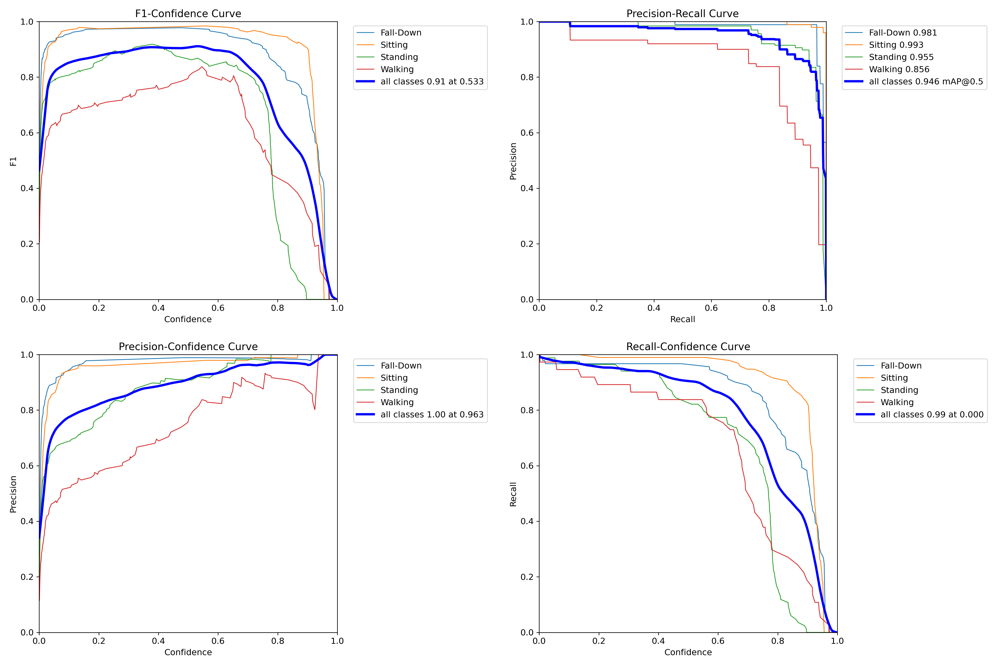

In [ ]:
# Show box curves of F1-Confident, Precision-Recall, Precision-Confident and Recall-Confident

# Load your images using OpenCV
img1 = cv2.imread(f'{train_path}/BoxF1_curve.png')
img2 = cv2.imread(f'{train_path}/BoxPR_curve.png')
img3 = cv2.imread(f'{train_path}/BoxP_curve.png')
img4 = cv2.imread(f'{train_path}/BoxR_curve.png')

# Concatenate images horizontally
top_row = cv2.hconcat([img1, img2])
bottom_row = cv2.hconcat([img3, img4])

# Concatenate the two rows vertically
grid = cv2.vconcat([top_row, bottom_row])

# Display the concatenated image
cv2_imshow(grid)


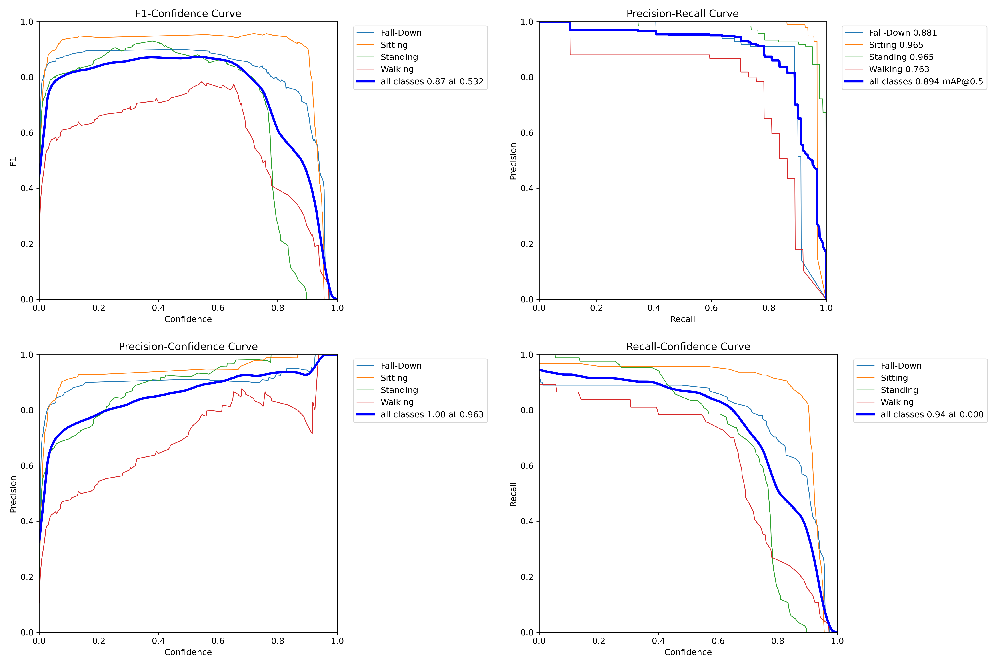

In [ ]:
# Show pose curves of F1-Confident, Precision-Recall, Precision-Confident and Recall-Confident

# Load your images using OpenCV
img1 = cv2.imread(f'{train_path}/PoseF1_curve.png')
img2 = cv2.imread(f'{train_path}/PosePR_curve.png')
img3 = cv2.imread(f'{train_path}/PoseP_curve.png')
img4 = cv2.imread(f'{train_path}/PoseR_curve.png')

# Concatenate images horizontally
top_row = cv2.hconcat([img1, img2])
bottom_row = cv2.hconcat([img3, img4])

# Concatenate the two rows vertically
grid = cv2.vconcat([top_row, bottom_row])

# Display the concatenated image
cv2_imshow(grid)


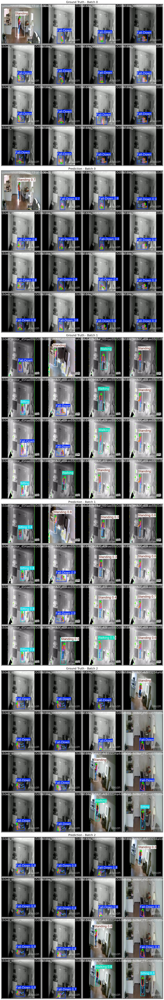

In [ ]:
# Validation Results: Ground Truth vs Prediction

# Load your images using matplotlib's imread
img1 = mpimg.imread(f'{train_path}/val_batch0_labels.jpg')
img2 = mpimg.imread(f'{train_path}/val_batch0_pred.jpg')
img3 = mpimg.imread(f'{train_path}/val_batch1_labels.jpg')
img4 = mpimg.imread(f'{train_path}/val_batch1_pred.jpg')
img5 = mpimg.imread(f'{train_path}/val_batch2_labels.jpg')
img6 = mpimg.imread(f'{train_path}/val_batch2_pred.jpg')

# Get image dimensions (assuming all images are of the same size)
img_height, img_width, _ = img1.shape

# Create a figure with subplots, adjusting the figure size to match the image size
fig, axes = plt.subplots(6, 1, figsize=(img_width / 100, 6 * img_height / 100))  # 6 rows, 1 column

# Add a title to the figure with a bigger font size
# fig.suptitle('Validation Results: Ground Truth vs Prediction', fontsize=24)

# Plot the images and add larger titles for each subplot
axes[0].imshow(img1)
axes[0].set_title("Ground Truth - Batch 0", fontsize=22)  # Larger subplot title
axes[1].imshow(img2)
axes[1].set_title("Prediction - Batch 0", fontsize=22)

axes[2].imshow(img3)
axes[2].set_title("Ground Truth - Batch 1", fontsize=22)
axes[3].imshow(img4)
axes[3].set_title("Prediction - Batch 1", fontsize=22)

axes[4].imshow(img5)
axes[4].set_title("Ground Truth - Batch 2", fontsize=22)
axes[5].imshow(img6)
axes[5].set_title("Prediction - Batch 2", fontsize=22)

# Turn off axes for all subplots
for ax in axes:
    ax.axis('off')

# Adjust layout to prevent overlap and show the title
plt.tight_layout(rect=[0, 0, 1, 0.95])

# Display the plot
plt.show()


In [ ]:
# Predict on test data using trained model

# Load trained model
model = YOLO('/content/runs/pose/train/weights/best.pt')

# Specify the test folder path
test_path = '/content/Human-activity-1/test/images'

# List all images in the test folder
image_files = [os.path.join(test_path, img) for img in os.listdir(test_path) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Predict each images
for img_path in image_files:
    results = model.predict(source=img_path, save=True, conf=0.50)



image 1/1 /content/Human-activity-1/test/images/clideo_editor_4c683234a4dc4a54afb78d1f1f397e4c_mp4-0032_jpg.rf.dceb694d4071a71cd254446fa02b9b81.jpg: 640x640 1 Standing, 478.4ms
Speed: 24.0ms preprocess, 478.4ms inference, 6.6ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/pose/predict

image 1/1 /content/Human-activity-1/test/images/clideo_editor_85054157ad054c5cb65c31780865562e_mp4-0104_jpg.rf.574c38c7706a6cce2ced971b648112f5.jpg: 640x640 1 Standing, 411.2ms
Speed: 4.0ms preprocess, 411.2ms inference, 2.7ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/pose/predict

image 1/1 /content/Human-activity-1/test/images/clideo_editor_454ae88c0d8f4113a208876eb58e9b67_mp4-0002_jpg.rf.2fe6bda6361bf5de2eac807c2399bdf3.jpg: 640x640 1 Sitting, 465.3ms
Speed: 4.0ms preprocess, 465.3ms inference, 2.2ms postprocess per image at shape (1, 3, 640, 640)
Results saved to runs/pose/predict

image 1/1 /content/Human-activity-1/test/images/clideo_editor_2229

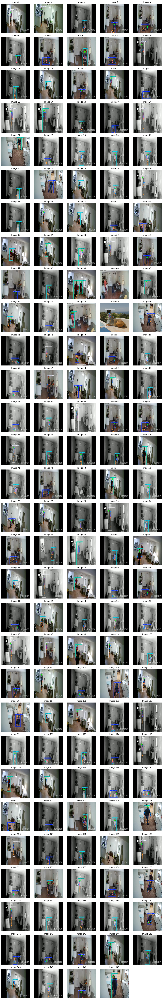

In [ ]:
# Plot prediction on test images

# Specify the predict folder path
pred_path = '/content/runs/pose/predict'

# List all images in the predict folder
pred_image_files = [os.path.join(pred_path, img) for img in os.listdir(pred_path) if img.endswith(('.jpg', '.jpeg', '.png'))]

# Number of images per row
images_per_row = 5

# Calculate the number of rows needed
n_rows = len(pred_image_files) // images_per_row + int(len(pred_image_files) % images_per_row != 0)

# Set figure size
fig, axs = plt.subplots(n_rows, images_per_row, figsize=(15, 3 * n_rows))

# Flatten axes if necessary (for easier iteration)
axs = axs.flatten()

# Loop through each image and display it
for i, img_path in enumerate(pred_image_files):
    img = mpimg.imread(img_path)      # Read the image
    axs[i].imshow(img)                # Show the image
    axs[i].axis('off')                # Turn off axis
    axs[i].set_title(f"Image {i+1}")  # Add title

# Hide any extra empty subplots (if the number of images is not a perfect multiple of images_per_row)
for j in range(i+1, len(axs)):
    axs[j].axis('off')  # Hide unused axes

# Display all images
plt.tight_layout()
plt.show()


# This project is only for learning purpose
The accuracy of the model is very low because it has been trained over very few epochs.